# Feature importances with forests of trees
ref: https://scikit-learn.org/stable/auto_examples/ensemble/plot_forest_importances.html

In [3]:
import sys
sys.path.append('../../')

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [4]:
# Trading Strategies powered by Machine Learning - Random Forest Classifier
from util.Save_result_return import save_to_csv
from util.plot_equity import plot_equity_trades
from config.constants import *
from util.load_data import *


In [37]:
from util.ATR import *
from util.SMA import *
from util.RSI import *
from util.LongBarSmallWick import *
from util.Bollinger_bands import *
from scipy.signal import argrelextrema

In [2]:
print(f'pandas  version: {pd.__version__}')
print(f'numpy   version: {np.__version__}')
print(f'seaborn version: {sns.__version__}')

pandas  version: 1.5.3
numpy   version: 1.23.5
seaborn version: 0.12.2


## Getting the Data

In [5]:
XAUUSD = load_data()

In [6]:
XAUUSD['H4'].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 25976 entries, 2007-01-01 00:00:00 to 2023-03-10 16:00:00
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Open    25976 non-null  float64
 1   High    25976 non-null  float64
 2   Low     25976 non-null  float64
 3   Close   25976 non-null  float64
 4   Volume  25976 non-null  int64  
dtypes: float64(4), int64(1)
memory usage: 1.2 MB


In [66]:
df = XAUUSD['H4'].copy()

## Add Features

### Signal

In [67]:
def Add_Signal(df):
        
        df["returns"] = np.log(df['Close'].div(df['Close'].shift(1)))
        df['signal_t1'] = np.sign(df.returns)
        df['signal'] = df.signal_t1.shift(-1)
        df.drop(columns=['returns', 'signal_t1'] , inplace=True)
        df = df.dropna()

        

In [68]:
Add_Signal(df)

### Simple moving average crossover

In [69]:
df['ATR'] = ATR(df, 20)['ATR']
df['sma_fast'] = SMA(df, 50, 200)['sma_fast']

### Short term breakout with RSI

In [70]:
df['RSI'] = rsi(df, 14)['RSI']
df['average_close'] = df['Close'].rolling(5).mean()

### Inside bar

In [71]:
df['inside_bar'] = np.where(((df['High'] < df['High'].shift(
    1)) & (df['Low'] > df['Low'].shift(1))), True, False)

### Long bar with small wicks

In [72]:
df['average_bar'] = average_bar_size(df)[
            'average_bar']
df['small_wick'] = small_wick(df, 0.2)['small_wick']

### Bolinger bands

In [73]:
df['upper_band'] = Bollinger_bands(df, 50, 3)['upper_band']

### London breakout

In [74]:
df['london_opening'] = np.where(
    (df.index.hour + 1) == 8, True, False)

### Momentum

In [77]:
df['direction'] = np.where(df['Close'] > df['Open'], 'bull', 'bear')
df['dir_count'] = df.groupby((df['direction'] != df['direction'].shift(1)).cumsum()).cumcount()+1


### Peak levels

In [76]:
price = df['Close']
minima_indices = argrelextrema(
price.values, np.less_equal, order=100)[0]
maxima_indices = argrelextrema(
price.values, np.greater_equal, order=100)[0]
df.loc[df.index[minima_indices],'min'] = price.iloc[minima_indices]
df.loc[df.index[maxima_indices], 'max'] = price.iloc[maxima_indices]

### Martingale

In [ ]:
## Same Momentum

### MACD

In [78]:
ema_s = 12  # EMA Short
ema_l = 26  # EMA Long
signal_mw = 9  # Moving Window for Signal Line

df["EMA_S"] = df['Close'].ewm(span=ema_s, min_periods=ema_s).mean()
df["EMA_L"] = df['Close'].ewm(span=ema_l, min_periods=ema_l).mean()
df["MACD"] = df["EMA_S"] - df["EMA_L"]
df["MACD_Signal"] = df["MACD"].ewm(span=signal_mw, min_periods=signal_mw).mean()

df.drop(columns=['EMA_S', 'EMA_L'], inplace=True)

###  Stochastic Oscilator

In [79]:
periods = 14
moving_av = 3

df["roll_low"] = df['Low'].rolling(periods).min()
df["roll_high"] = df['High'].rolling(periods).max()
df["K"] = (df.Close - df.roll_low) / (df.roll_high - df.roll_low) * 100
df["D"] = df.K.rolling(moving_av).mean()
df["sinal_stoc"] = np.where(df["K"] > df["D"], 1, -1)
df.drop(columns=['roll_low', 'roll_high'], inplace=True)

In [80]:
df.drop(columns=['min', 'max'], inplace=True)

In [81]:
data = df.copy()

In [84]:
data.drop(columns=['diff', 'gains', 'losses',
          'average_gains', 'average_losses', 'average_close', 'average_bar'], inplace=True)

In [85]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 25976 entries, 2007-01-01 00:00:00 to 2023-03-10 16:00:00
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Open            25976 non-null  float64
 1   High            25976 non-null  float64
 2   Low             25976 non-null  float64
 3   Close           25976 non-null  float64
 4   Volume          25976 non-null  int64  
 5   signal          25975 non-null  float64
 6   ATR             25956 non-null  float64
 7   sma_fast        25927 non-null  float64
 8   sma_slow        25777 non-null  float64
 9   RSI             25972 non-null  float64
 10  inside_bar      25976 non-null  bool   
 11  small_wick      25976 non-null  bool   
 12  rolling_mean    25927 non-null  float64
 13  rolling_std     25927 non-null  float64
 14  upper_band      25927 non-null  float64
 15  lower_band      25927 non-null  float64
 16  london_opening  25976 non-null  bool   
 

In [90]:
df = data.copy()

In [91]:
sns.pairplot(df,
             kind='reg',
             plot_kws={'scatter_kws': {'alpha': 0.4},
                       'line_kws': {'color': 'orange'}},
             diag_kws={'color': 'green', 'alpha':.2});

<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


## sklearn: Classifier

In [92]:
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Perceptron
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn import metrics

In [93]:
print(f'sklearn version: {sklearn.__version__}')

sklearn version: 1.2.1


In [94]:
df.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'signal', 'ATR', 'sma_fast',
       'sma_slow', 'RSI', 'inside_bar', 'small_wick', 'rolling_mean',
       'rolling_std', 'upper_band', 'lower_band', 'london_opening',
       'direction', 'dir_count', 'MACD', 'MACD_Signal', 'K', 'D',
       'sinal_stoc'],
      dtype='object')

In [99]:
df.drop(columns=['direction'], inplace=True)

In [104]:
df.dropna(inplace=True)

In [105]:
df

,Open,High,Low,Close,Volume,signal,ATR,sma_fast,sma_slow,RSI,...,rolling_std,upper_band,lower_band,london_opening,dir_count,MACD,MACD_Signal,K,D,sinal_stoc
Time,,,,,,,,,,,,,,,,,,,,,
2007-02-14 04:00:00,666.747,668.229,665.077,668.147,233,-1.0,3.71610,656.28686,637.734240,54.308535,...,7.040041,677.406983,635.166737,False,2,2.533966,2.539497,92.629218,70.496483,1
2007-02-14 08:00:00,668.170,670.207,666.899,667.768,235,1.0,3.79880,656.51950,637.895595,55.397712,...,7.224723,678.193669,634.845331,False,1,2.631368,2.557872,78.117710,83.037911,-1
2007-02-14 12:00:00,667.574,671.708,665.393,667.841,239,1.0,3.90450,656.97644,638.056305,54.891190,...,7.203364,678.586531,635.366349,False,1,2.683517,2.583001,69.423579,80.056836,-1
2007-02-14 16:00:00,667.584,669.320,664.370,668.513,236,-1.0,3.66935,657.40776,638.218905,60.318383,...,7.236154,679.116223,635.699297,False,2,2.747400,2.615881,74.737092,74.092794,1
2007-02-14 20:00:00,668.430,669.523,667.506,668.469,155,-1.0,3.47210,657.83582,638.381220,62.527315,...,7.244945,679.570654,636.100986,False,3,2.762632,2.645231,74.389183,72.849951,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-03-09 20:00:00,1830.495,1832.215,1828.935,1831.415,180,-1.0,7.82650,1832.17086,1863.396080,51.200759,...,14.367018,1875.271915,1789.069805,False,5,-3.177221,-4.718876,84.230725,65.794207,1
2023-03-10 00:00:00,1831.428,1834.765,1827.974,1829.085,240,1.0,7.78390,1832.41046,1862.851480,54.229337,...,14.209670,1875.039471,1789.781449,False,1,-2.535414,-4.282183,75.377133,74.916245,1
2023-03-10 04:00:00,1829.085,1834.575,1827.675,1833.405,240,1.0,8.04590,1832.78206,1862.333880,57.659786,...,13.981517,1874.726611,1790.837509,False,1,-1.659065,-3.757560,91.792378,83.800079,1


In [106]:
# model= DecisionTreeClassifier(random_state=7)
model= RandomForestClassifier(n_estimators=250, random_state=7)
# model= ExtraTreesClassifier(n_estimators=250, random_state=7)
X = df[['Open', 'High', 'Low', 'Close', 'Volume', 'ATR', 'sma_fast',
        'sma_slow', 'RSI', 'inside_bar', 'small_wick', 'rolling_mean',
       'rolling_std', 'upper_band', 'lower_band', 'london_opening'
        , 'dir_count', 'MACD', 'MACD_Signal', 'K', 'D',
        'sinal_stoc']]
y = df['signal']
model.fit(X,y)

RandomForestClassifier(n_estimators=250, random_state=7)

In [107]:
model.feature_importances_

array([0.05016221, 0.0492081 , 0.04955049, 0.04985537, 0.02270015,
       0.06781029, 0.04788545, 0.0570666 , 0.07174665, 0.00863175,
       0.00724166, 0.04784469, 0.06489855, 0.05232099, 0.05232471,
       0.        , 0.02289273, 0.06585139, 0.06587459, 0.07116644,
       0.06999791, 0.00496929])

In [108]:
fs=pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=True)
fs

london_opening    0.000000
sinal_stoc        0.004969
small_wick        0.007242
inside_bar        0.008632
Volume            0.022700
dir_count         0.022893
rolling_mean      0.047845
sma_fast          0.047885
High              0.049208
Low               0.049550
Close             0.049855
Open              0.050162
upper_band        0.052321
lower_band        0.052325
sma_slow          0.057067
rolling_std       0.064899
MACD              0.065851
MACD_Signal       0.065875
ATR               0.067810
D                 0.069998
K                 0.071166
RSI               0.071747
dtype: float64

In [109]:
fs.sum()

1.0

<Axes: >

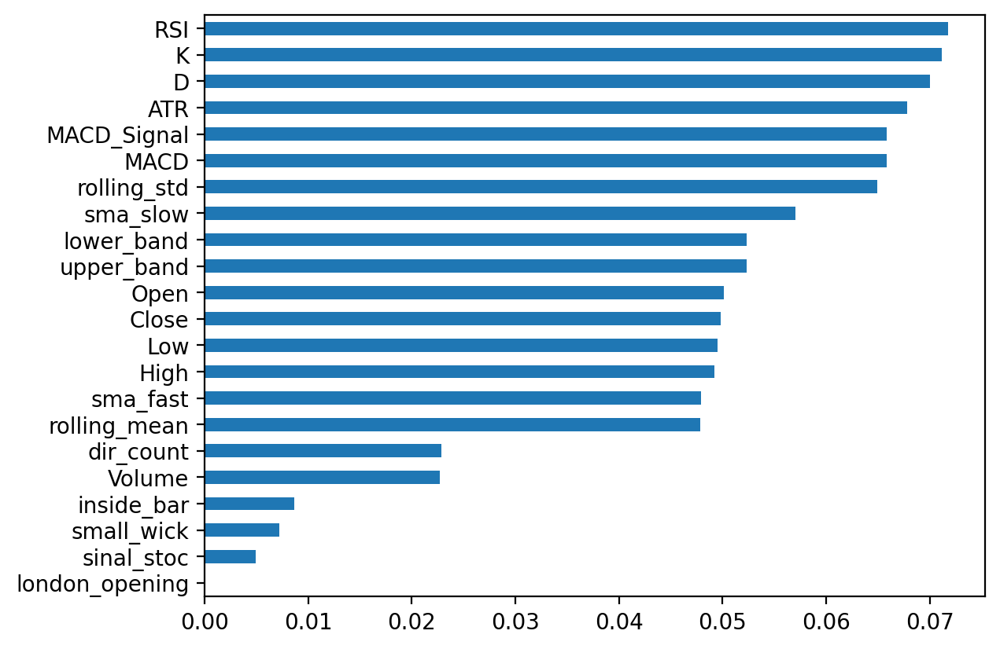

In [110]:
fs.plot(kind='barh')

In [112]:
fs.nlargest(4) #.index

RSI    0.071747
K      0.071166
D      0.069998
ATR    0.067810
dtype: float64

In [115]:
X = df[['RSI', 'K', 'D', 'ATR']]
# X=df[['Glucose', 'BMI', 'Age', 'DiabetesPedigreeFunction']]
# X=df[fs[fs > .1].index]
y=df['signal']

In [116]:
# use stratify to split train/test
test_size=.3
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=test_size,
                                                    stratify=y,
                                                    random_state=7)

## scikit-learn: confusion matrix
$$
\begin{bmatrix}
C_{0,0} & C_{0,1} \\
C_{1,0} & C_{1,1}
\end{bmatrix}
=
\begin{bmatrix}
tn&fp \\
fn&tp
\end{bmatrix}
$$

<table>
<tr>
    <td></td>
    <td>predicted false</td>
    <td>predicted true</td>
</tr>
<tr>
    <td>actual false</td>
    <td>tn</td>
    <td>fp</td>
</tr>
<tr>
    <td>actual true</td>
    <td>fn</td>
    <td>tp</td>
</tr>
<table>

In [117]:
algo=[
    [KNeighborsClassifier(n_neighbors=5), 'KNeighborsClassifier'],
    [LogisticRegression(solver='lbfgs'), 'LogisticRegression'],
    [Perceptron(), 'Perceptron'],
    [DecisionTreeClassifier(min_samples_split=10), 'DecisionTreeClassifier'],
    [GradientBoostingClassifier(), 'GradientBoostingClassifier'],
    [RandomForestClassifier(), 'RandomForestClassifier'],
    [BaggingClassifier(), 'BaggingClassifier'],
    [AdaBoostClassifier(), 'AdaBoostClassifier'],
    [GaussianNB(), 'GaussianNB'],
    [MLPClassifier(), 'MLPClassifier'],
    [SVC(kernel='linear'), 'SVC_linear'],
    [GaussianProcessClassifier(), 'GaussianProcessClassifier']
]
model_scores=[]
for a in algo:
    model = a[0]
    model.fit(X_train, y_train)
    score=model.score(X_test, y_test)
    model_scores.append([score, a[1]])
    y_pred=model.predict(X_test)
    print(f'{a[1]:20} score: {score:.04f}')
    print(metrics.confusion_matrix(y_test, y_pred))
    print(metrics.classification_report(y_test, y_pred))
    print('-' * 100)

print(model_scores)
print(f'best score = {max(model_scores)}')

KNeighborsClassifier score: 0.5058
[[1871    0 1933]
 [   0    0    4]
 [1885    0 2040]]
              precision    recall  f1-score   support

        -1.0       0.50      0.49      0.49      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.51      0.52      0.52      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg       0.51      0.51      0.51      7733

----------------------------------------------------------------------------------------------------


c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\line

LogisticRegression   score: 0.5123
[[1554    0 2250]
 [   3    0    1]
 [1517    0 2408]]
              precision    recall  f1-score   support

        -1.0       0.51      0.41      0.45      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.52      0.61      0.56      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg       0.51      0.51      0.51      7733

----------------------------------------------------------------------------------------------------
Perceptron           score: 0.5099
[[2275    0 1529]
 [   2    0    2]
 [2257    0 1668]]


c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

        -1.0       0.50      0.60      0.55      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.52      0.42      0.47      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg       0.51      0.51      0.51      7733

----------------------------------------------------------------------------------------------------
DecisionTreeClassifier score: 0.5015
[[1934    1 1869]
 [   3    0    1]
 [1981    0 1944]]
              precision    recall  f1-score   support

        -1.0       0.49      0.51      0.50      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.51      0.50      0.50      3925

    accuracy                           0.50      7733
   macro avg       0.33      0.33      0.33      7733
weighted avg       0.50      0.50      0.50      7733

---------------------------------------------

c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


BaggingClassifier    score: 0.4983
[[2177    0 1627]
 [   2    0    2]
 [2249    0 1676]]
              precision    recall  f1-score   support

        -1.0       0.49      0.57      0.53      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.51      0.43      0.46      3925

    accuracy                           0.50      7733
   macro avg       0.33      0.33      0.33      7733
weighted avg       0.50      0.50      0.50      7733

----------------------------------------------------------------------------------------------------


c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


AdaBoostClassifier   score: 0.5126
[[1667    0 2137]
 [   2    0    2]
 [1627    1 2297]]
              precision    recall  f1-score   support

        -1.0       0.51      0.44      0.47      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.52      0.59      0.55      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg       0.51      0.51      0.51      7733

----------------------------------------------------------------------------------------------------
GaussianNB           score: 0.5064
[[1898    0 1906]
 [   2    0    2]
 [1907    0 2018]]
              precision    recall  f1-score   support

        -1.0       0.50      0.50      0.50      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.51      0.51      0.51      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg

c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MLPClassifier        score: 0.5058
[[  98    0 3706]
 [   1    0    3]
 [ 112    0 3813]]
              precision    recall  f1-score   support

        -1.0       0.46      0.03      0.05      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.51      0.97      0.67      3925

    accuracy                           0.51      7733
   macro avg       0.32      0.33      0.24      7733
weighted avg       0.49      0.51      0.36      7733

----------------------------------------------------------------------------------------------------


c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


SVC_linear           score: 0.5095
[[1966    0 1838]
 [   2    0    2]
 [1951    0 1974]]
              precision    recall  f1-score   support

        -1.0       0.50      0.52      0.51      3804
         0.0       0.00      0.00      0.00         4
         1.0       0.52      0.50      0.51      3925

    accuracy                           0.51      7733
   macro avg       0.34      0.34      0.34      7733
weighted avg       0.51      0.51      0.51      7733

----------------------------------------------------------------------------------------------------


c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Win10\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


MemoryError: Unable to allocate 2.43 GiB for an array with shape (18043, 18043) and data type float64

In [118]:
model_scores

[[0.5057545583861374, 'KNeighborsClassifier'],
 [0.5123496702444071, 'LogisticRegression'],
 [0.5098926677874046, 'Perceptron'],
 [0.5014871330660804, 'DecisionTreeClassifier'],
 [0.5100219837061942, 'GradientBoostingClassifier'],
 [0.511703090650459, 'RandomForestClassifier'],
 [0.49825423509634037, 'BaggingClassifier'],
 [0.5126083020819863, 'AdaBoostClassifier'],
 [0.5064011379800853, 'GaussianNB'],
 [0.5057545583861374, 'MLPClassifier'],
 [0.5095047200310359, 'SVC_linear']]

In [119]:
dscore=pd.DataFrame(model_scores, columns=['score', 'classifier'])
dscore.sort_values('score', ascending=False)

,score,classifier
7,0.512608,AdaBoostClassifier
1,0.512350,LogisticRegression
5,0.511703,RandomForestClassifier
4,0.510022,GradientBoostingClassifier
2,0.509893,Perceptron
10,0.509505,SVC_linear
8,0.506401,GaussianNB
0,0.505755,KNeighborsClassifier
9,0.505755,MLPClassifier
3,0.501487,DecisionTreeClassifier
